In [1]:
import os   #used for directory work
import matplotlib.pyplot as plt   #used for creating plots
import matplotlib.patches as mpatches #used for plot legends
import pandas as pd
import numpy as np

In [2]:
def plotting(path,burn,min_temp = 0):

    txt_files=[]
    all_files = os.listdir(path) #tells what directory the files are in
    for i in all_files: #reading only the .txt files 
        if i[-4:] == ".txt":
            txt_files.append(i)
            
    txt_files.sort() #alphabetizes them
    
    blue_patch = mpatches.Patch(color='blue', label='U')
    gree_patch = mpatches.Patch(color='green', label='V')
    blac_patch = mpatches.Patch(color='k', label='W')
    red_patch  = mpatches.Patch(color='indianred', label='Temperature')
    lbls = ["Temperature", "U","V","W"]
    fig, axs = plt.subplots(nrows=4,ncols=4,figsize=(28,16))
    file = 0
    mean_list = []
    for col in range(4):
            for row in range(4): 
                df = pd.read_csv(path + txt_files[file],na_values = ['NAN',"00nan"], sep=' ')
                
                time_s = []
                for t in range(len(df)):
                    time_s.append(round((float(df["Hr"][t]))*3600+float(df["Min"][t])*60 + float(df["Sec"][t])\
                                  -((float(df["Hr"][0]))*3600+float(df["Min"][0])*60 + float(df["Sec"][0])),4))
                mean_list.append(min(df["T"]))
                ax1 = axs[col,row]
                ax1.plot(time_s, df["T"], c = "indianred", linewidth = .3)#,label = "T")
                ax1.set_ylim(min_temp,80)
                ax1.grid()
                ax1.set_title(txt_files[file][:2], fontsize = 16)
                ax1.tick_params(labelsize=12)
                #ax1.set_ylabel(r"Temperature")
                
                axs2 = ax1.twinx()
                axs2.plot(time_s, [float(i) for i in list(df["U"])], c = "b", linewidth=.05)# label = "U")
                axs2.plot(time_s, [float(i) for i in list(df["V"])], c = "g", linewidth = .05)#,label = "V")
                axs2.plot(time_s, [float(i) for i in list(df["W"])], c = "k", linewidth = .05)#, label = "W")
                axs2.set_ylim(-6,6)
                axs2.set_xlim(min(time_s),max(time_s))
                axs2.tick_params(labelsize=12)
                #axs2.set_ylabel(r"Wind Speed $\frac{m}{s}$")
                file += 1
    fig.suptitle("Time Series of Burn "+ burn, fontsize = 32, y= .95, x = .4)
    #handles, labels = axs2.get_legend_handles_labels()
    fig.legend(handles=[red_patch,blue_patch,gree_patch,blac_patch],labels =lbls , ncol = 2, fontsize = 20,loc= "center", bbox_to_anchor=(.7,.94), framealpha = .2)
    fig.text(0.48,0.07, "Time (s)", fontsize = 24)
    fig.text(0.09,0.45, "Temperature (C)",rotation = 90, fontsize = 24)
    fig.text(0.92,0.45,r"Wind Speed ($\frac{m}{s}$)", rotation= 90,fontsize = 24)
    fig.savefig("Burn-"+burn+"-Raw-UVWT-grid", dpi = 450)
    print(mean_list)       

[4.99, 4.72, 4.75, 5.85, 6.75, 4.84, 5.12, 5.1, 6.83, 6.2, 5.33, 5.67, 4.75, 4.87, 5.44, 5.63]


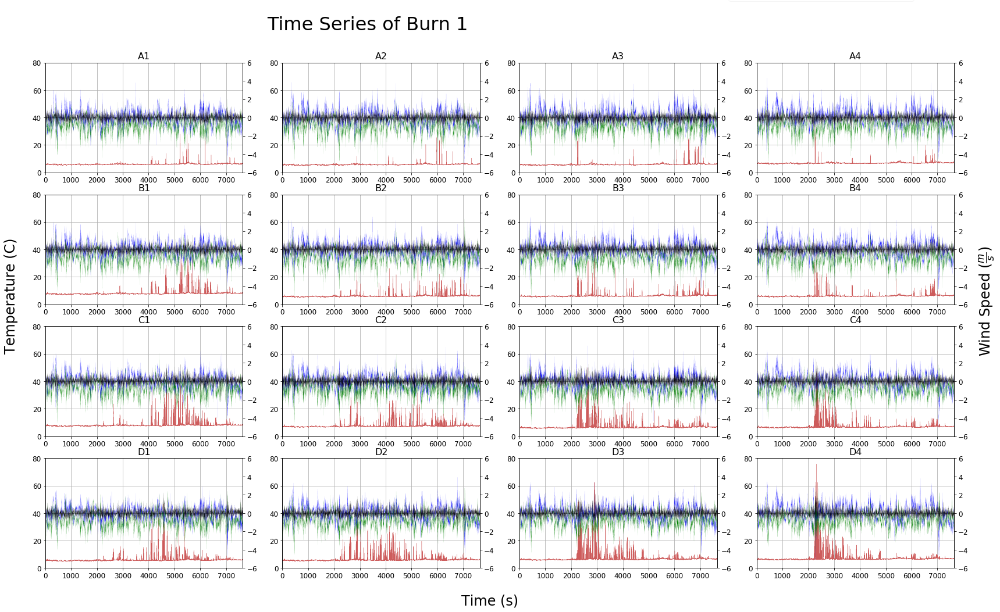

In [48]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-1/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-1/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-1/sonics/" #79 location
plotting(path,str(1))

[5.62, 5.47, nan, 6.67, 7.48, 5.57, 5.75, 5.77, 7.48, 6.9, 6.05, 6.3, 5.35, 5.54, 5.95, 6.12]


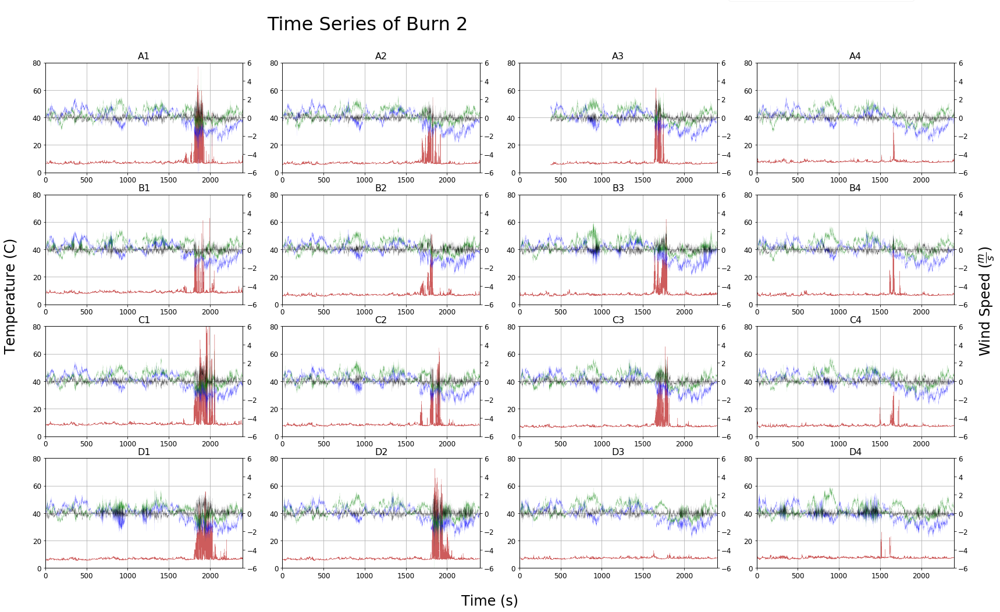

In [49]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-2/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-2/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-2/sonics/" 
plotting(path,str(2))

[7.2, 6.97, 6.98, 8.1, 8.96, 7.07, 7.28, 7.27, 8.99, 8.35, 7.58, 7.87, 6.87, 6.97, 7.55, 7.73]


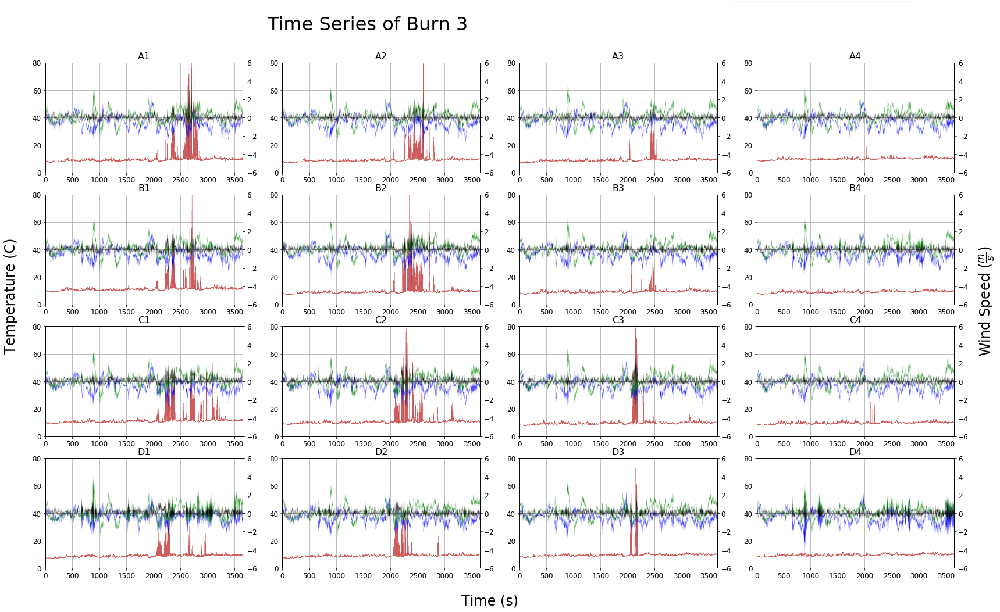

In [50]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-3/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-3/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-3/sonics/" 
plotting(path,str(3))

[0.55, 0.25, 0.2, 1.25, 2.25, 0.32, 0.5, 0.51, 2.24, 1.67, 0.77, 1.11, 0.3, 0.37, 0.95, 1.06]


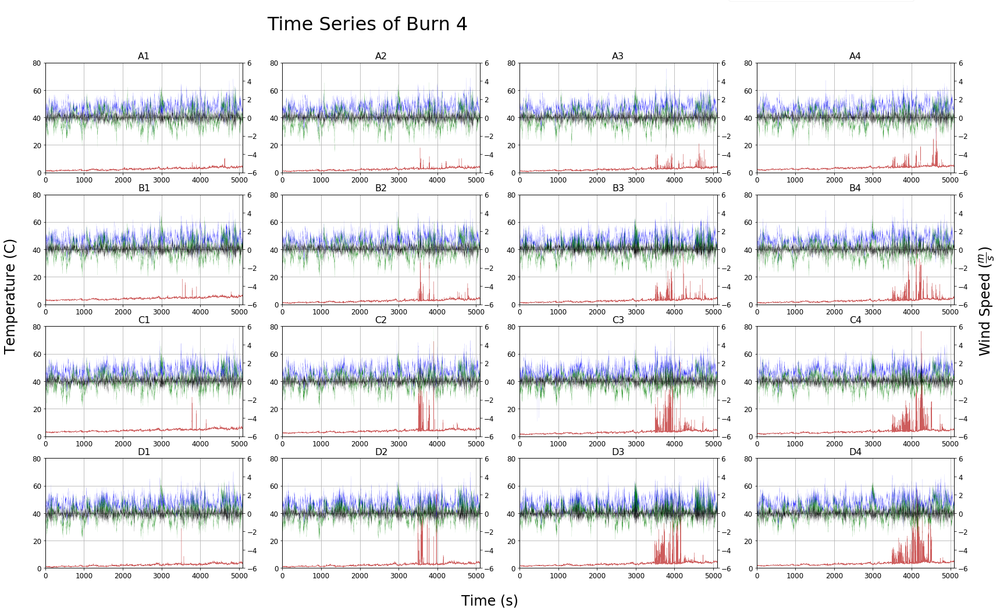

In [51]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-4/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-4/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-4/sonics/" 
plotting(path,str(4))

[4.18, 3.73, 3.83, 4.97, 5.79, 3.92, 4.17, 4.28, 5.9, 5.5, 4.53, 5.06, 3.87, 4.14, 4.68, 4.9]


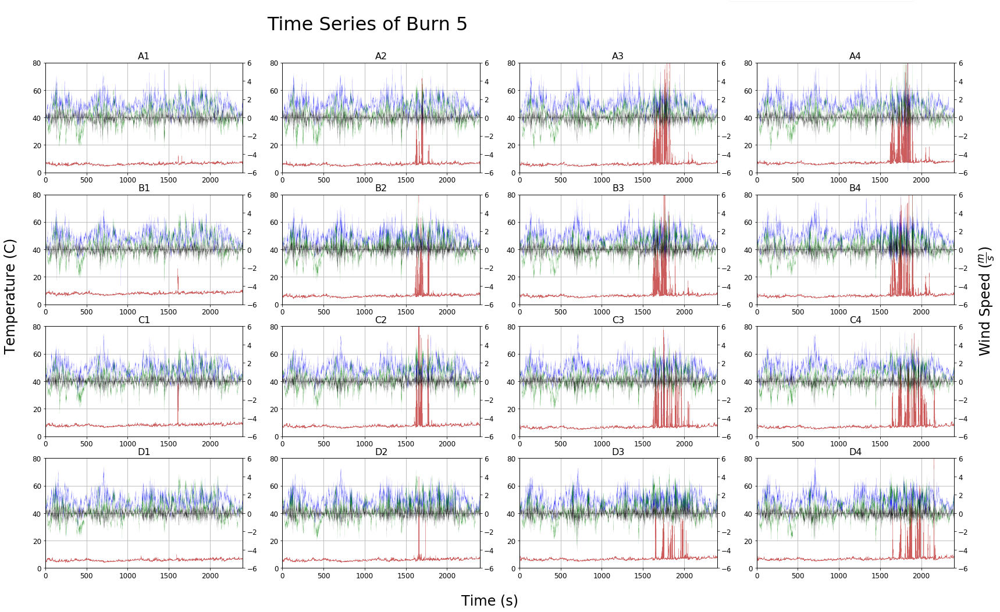

In [52]:
path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-5/sonics/"  #134 location
path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-5/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-5/sonics/" 
plotting(path,str(5))

[4.18, 3.73, 3.83, 4.97, 5.79, 3.92, 4.17, 4.28, 5.9, 5.5, 4.53, 5.06, 3.87, 4.14, 4.68, 4.9]


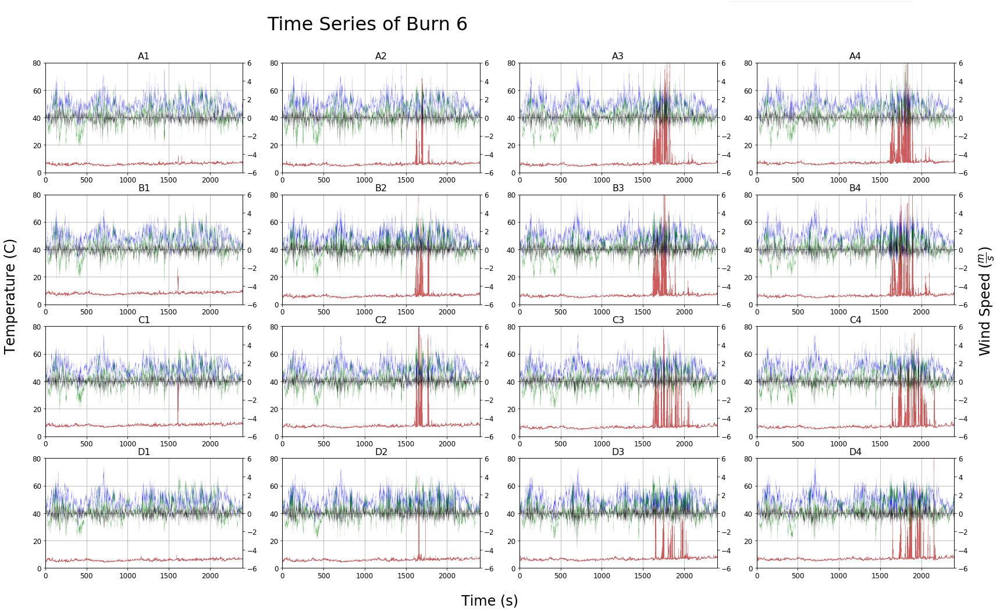

In [53]:
path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-6/sonics/"  #134 location
path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-6/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-5/sonics/" 
plotting(path,str(6))

[18.91, 19.92, 18.59, 18.68, 20.41, 18.52, 21.49, 18.73, 18.32, 18.49, 19.15, 19.07, 20.43, 19.77, 19.02, 19.37]


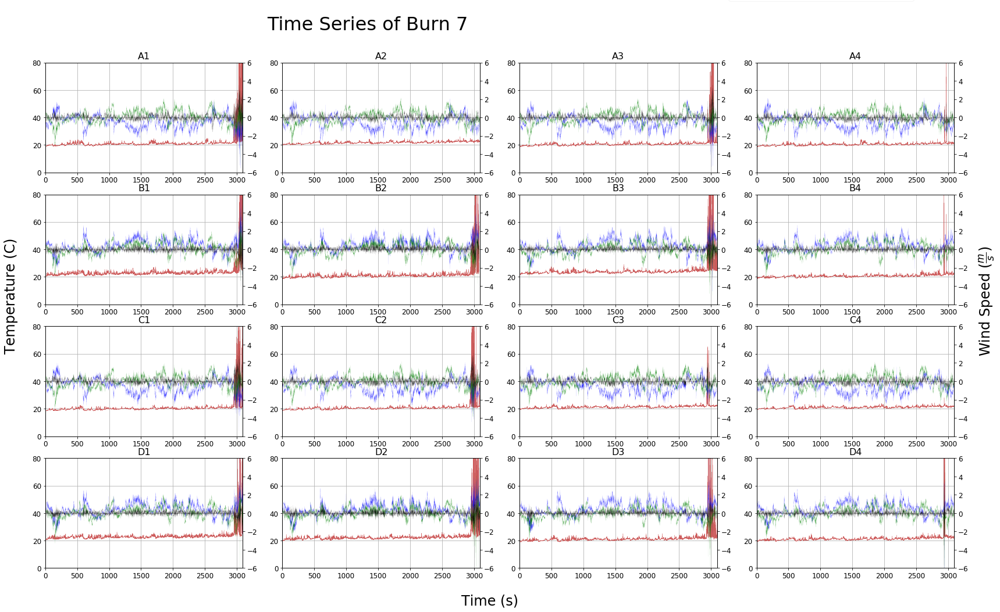

In [55]:
path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-7/sonics/"  #134 location
path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-7/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-7/sonics/" 
plotting(path,str(7))

[21.92, 23.03, 21.58, 21.77, 22.26, nan, 22.88, 20.74, 22.4, 21.48, 20.85, 21.44, 21.22, 21.55, 22.28, 22.31]


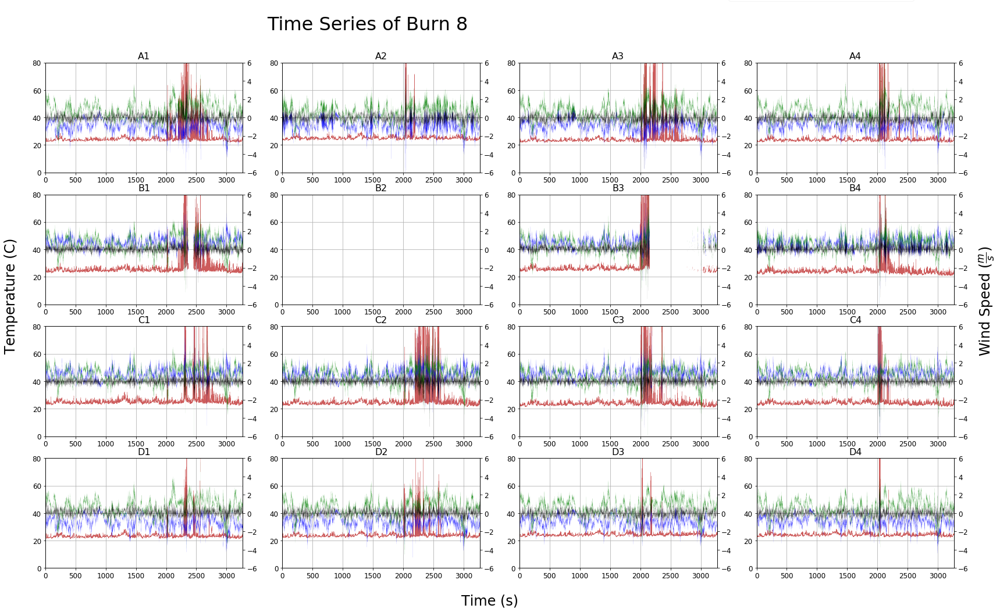

In [56]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-8/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-8/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-8/sonics/" 
plotting(path,str(8))

[17.28, 18.39, 17.11, 17.06, 18.08, 17.49, 17.26, 16.23, 16.7, 17.11, 17.93, 17.88, 18.22, 17.28, 16.42, 17.15]


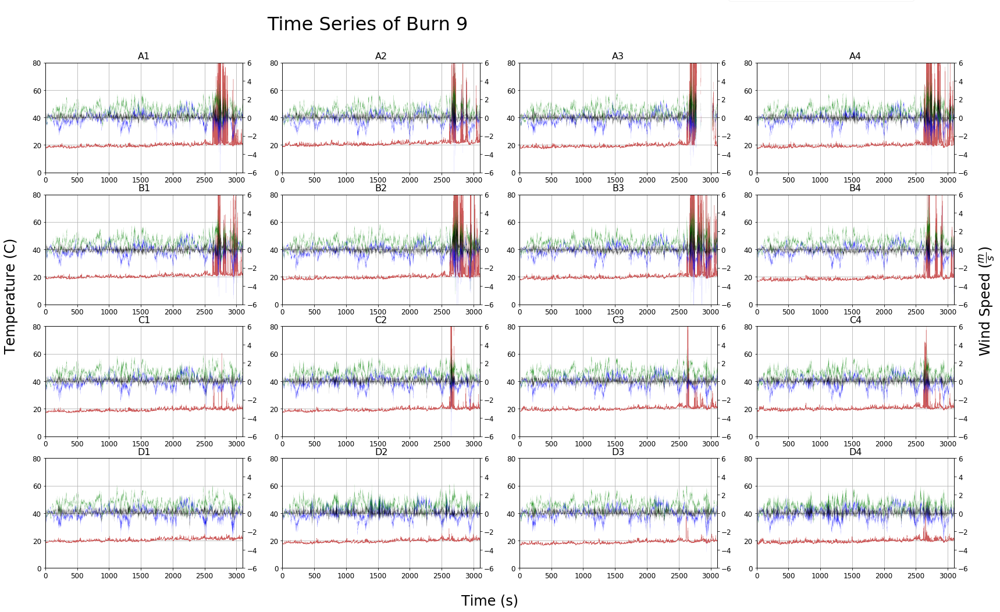

In [3]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-9/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-9/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-9/sonics/" 
plotting(path,str(9))

[21.82, 22.79, 20.97, 21.34, 22.64, 21.64, 21.73, 20.77, 21.32, 21.59, 22.07, 22.16, 22.73, 21.84, 21.01, 21.53]


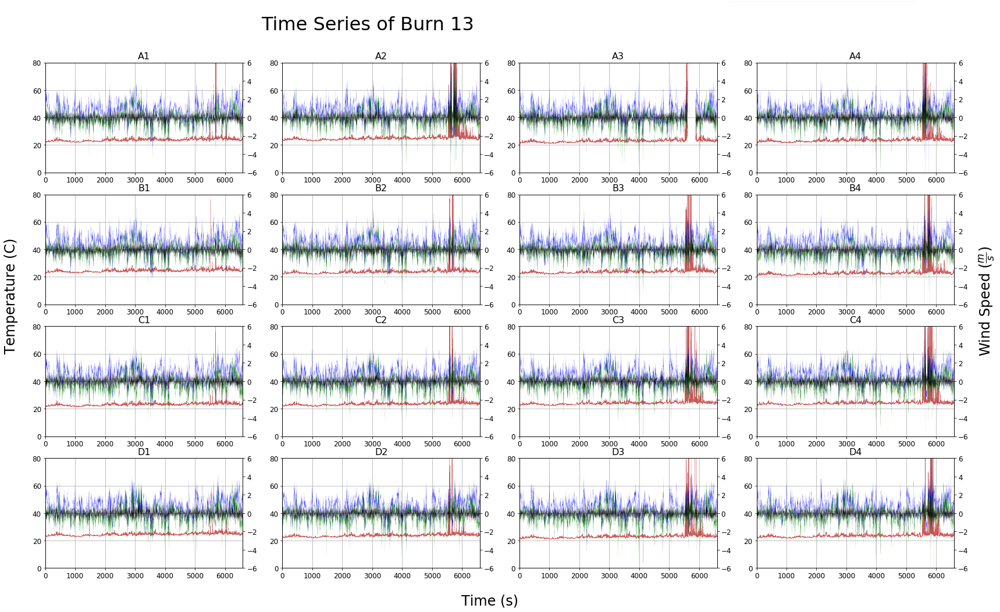

In [58]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-13/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-13/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-13/sonics/" 
plotting(path,str(13))

[19.43, 20.65, 18.74, 19.16, 20.28, 19.21, 19.54, 18.42, 18.98, 19.24, 20.06, 19.8, 20.37, 19.47, 18.8, 19.46]


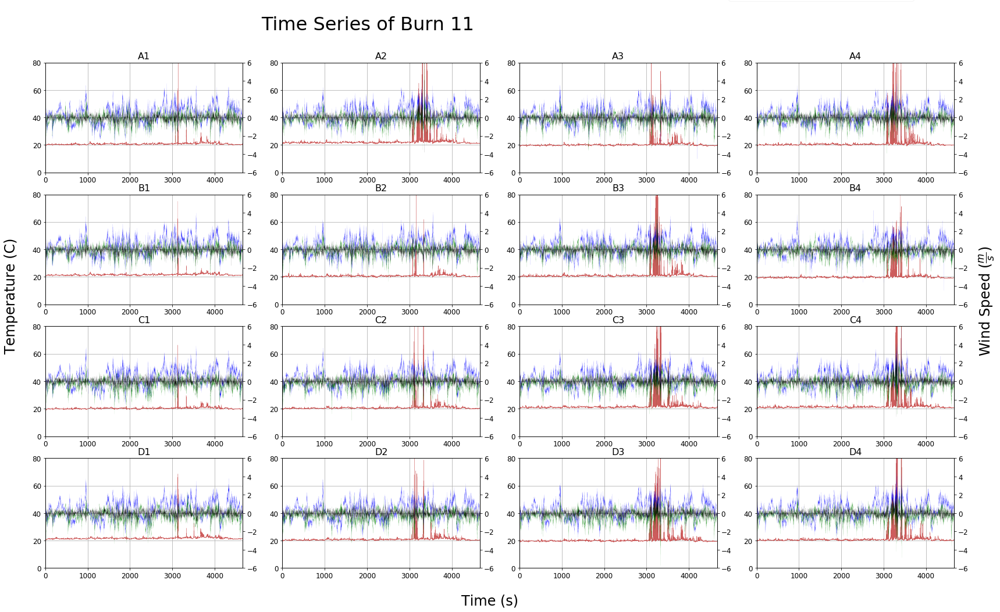

In [59]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-11/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-11/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-11/sonics/" 
plotting(path,str(11))

[19.83, 20.88, 19.04, 19.46, 20.74, 19.67, 19.83, 18.8, 19.36, 19.61, 20.13, 20.33, 20.81, 19.95, 18.98, 19.74]


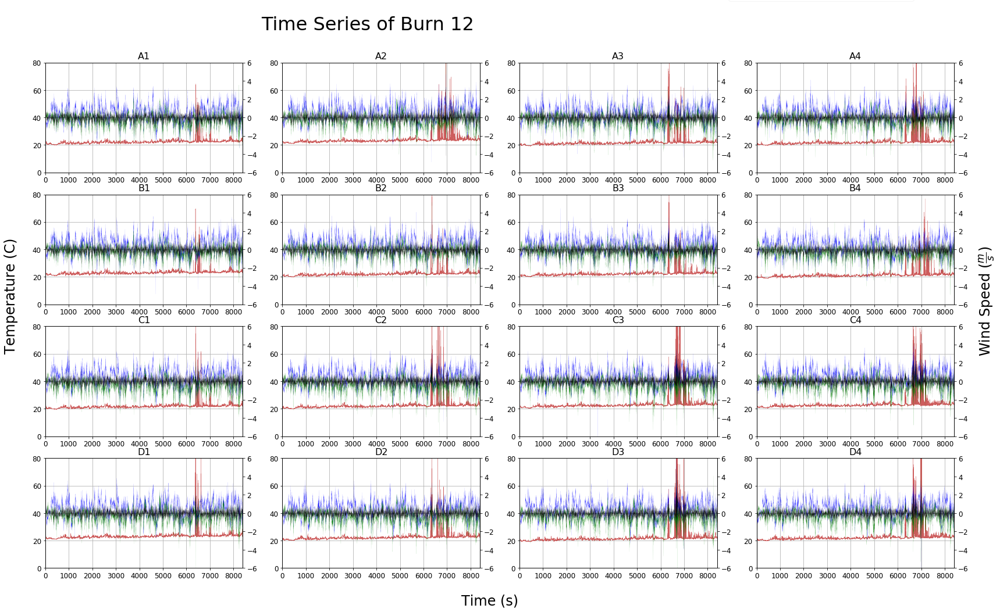

In [60]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-12/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-12/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-12/sonics/" 
plotting(path,str(12))

[22.47, 21.54, 21.74, 20.5, 21.73, 21.11, 21.68, 22.47, 21.32, 21.68, 22.42, 22.28, 22.69, 21.92, 21.03, 21.42]


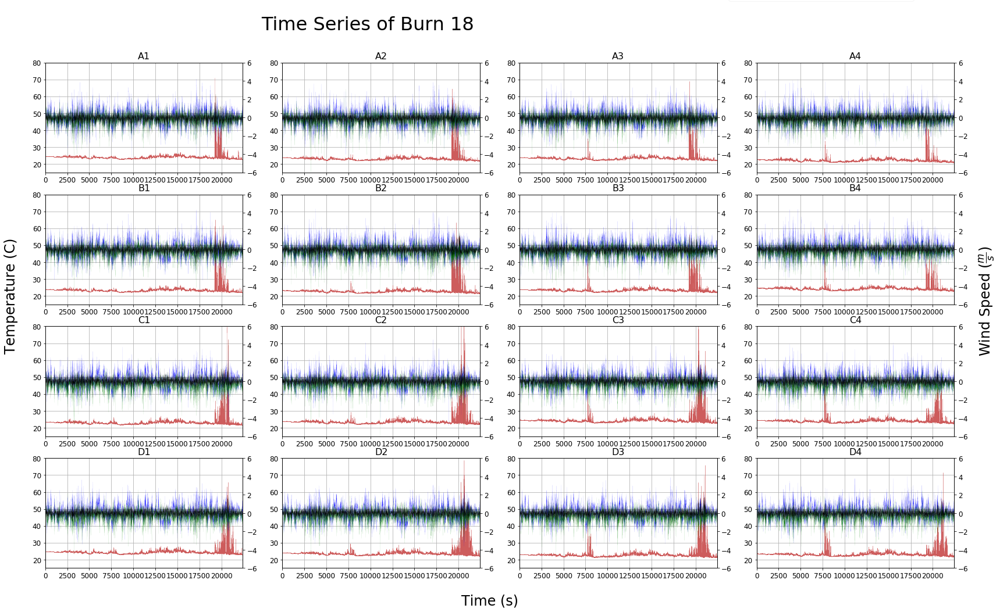

In [61]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-18/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-18/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-18/sonics/"    #79 location
plotting(path,str(18),15)

[18.8, 18.0, 18.08, 16.99, 18.03, 17.59, 18.01, 18.81, 17.79, 18.05, 18.68, 18.78, 18.97, 18.27, 17.32, 17.79]


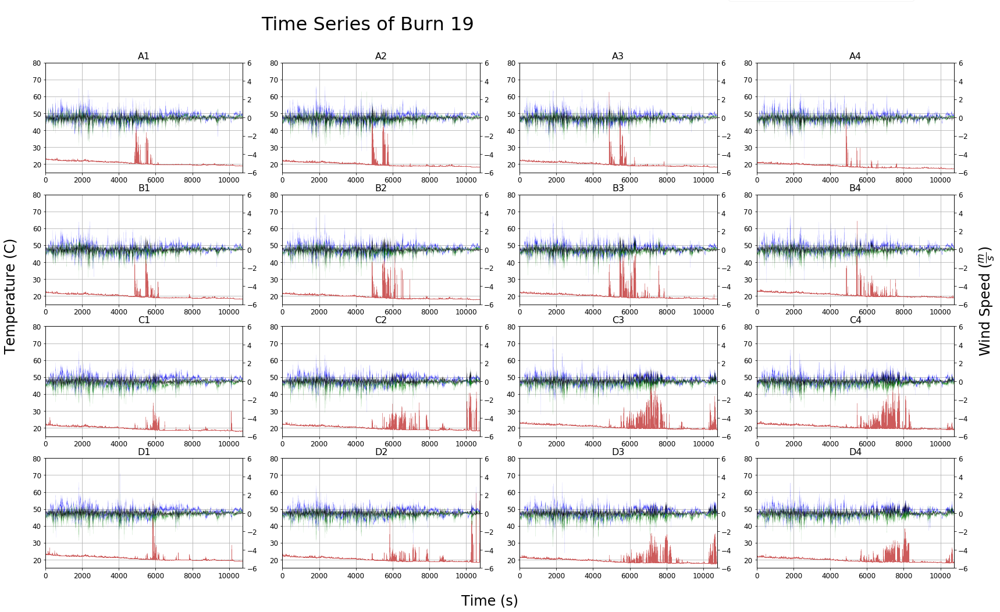

In [62]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-19/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-19/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-19/sonics/"    #79 location
plotting(path,str(19),15)

[30.79, 30.66, 31.02, 29.38, 30.29, 29.18, 29.39, 29.04, 30.04, 31.09, 31.23, 31.34, 31.38, 30.09, 30.03, 29.45]


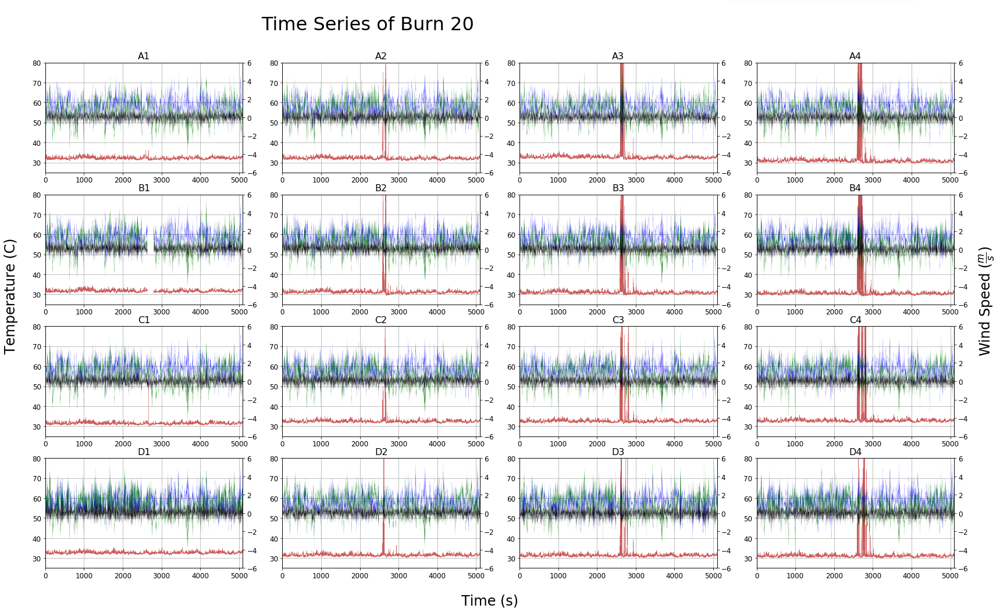

In [63]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-1/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-1/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-20/sonics/" #79 location

plotting(path,str(20),25)

[30.38, 30.11, 30.44, 28.78, 29.87, 29.06, 28.77, 29.16, 29.71, 30.51, 30.51, 30.43, 30.89, 29.47, 29.52, 29.13]


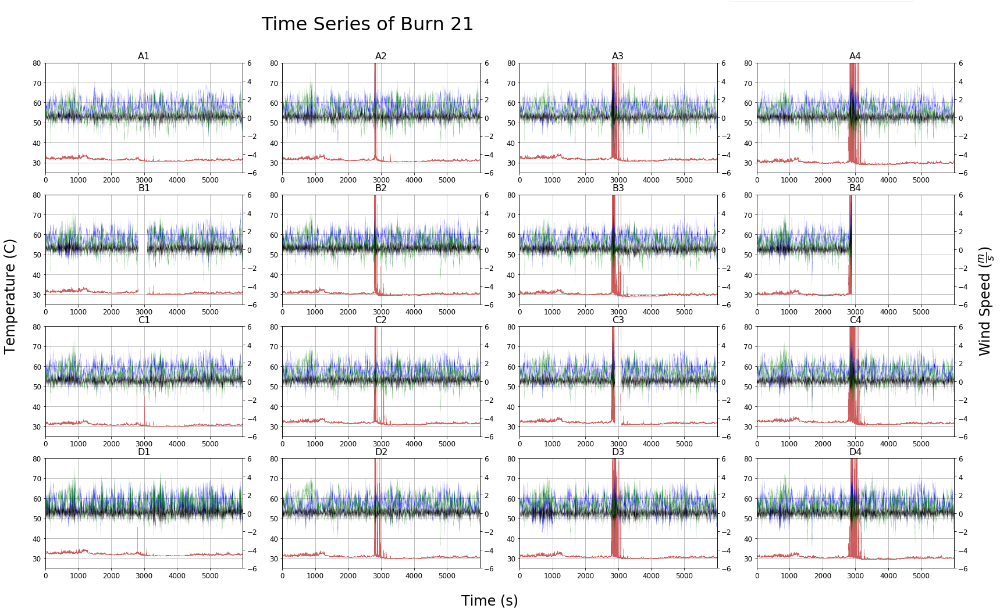

In [64]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-21/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-21/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-21/sonics/" #79 location

plotting(path,str(21),25)

[30.17, 29.81, 30.26, 28.41, 29.58, 28.58, 28.65, nan, 29.48, 30.24, 30.28, 30.04, 30.62, 29.38, 29.31, 28.94]


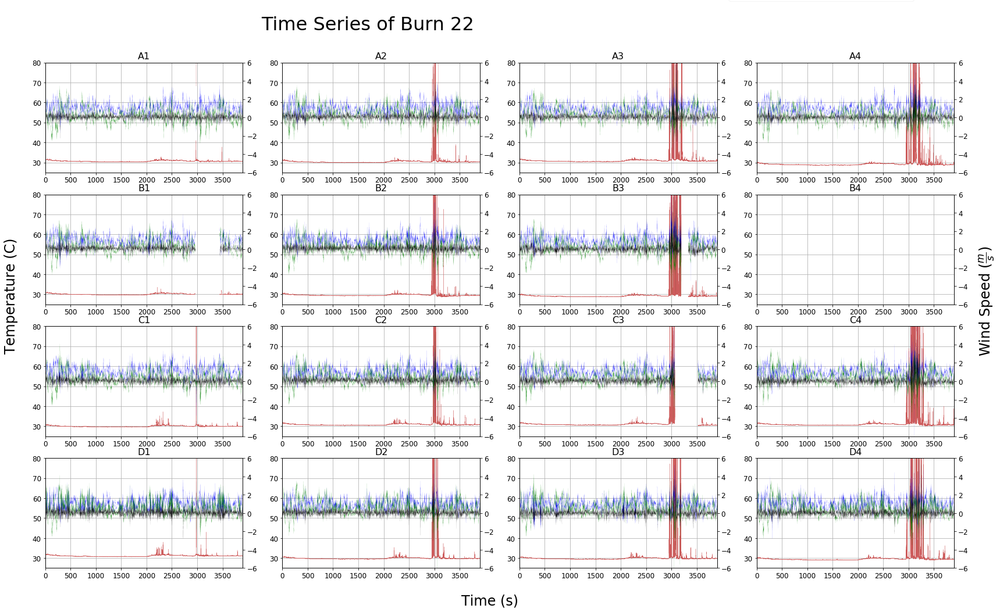

In [65]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-22/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-22/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-22/sonics/" #79 location

plotting(path,str(22),25)

[15.73, 15.14, 15.38, 13.59, 14.97, 14.51, 13.9, nan, 15.28, 15.47, 15.41, 15.37, 15.99, 14.62, 14.53, 14.01]


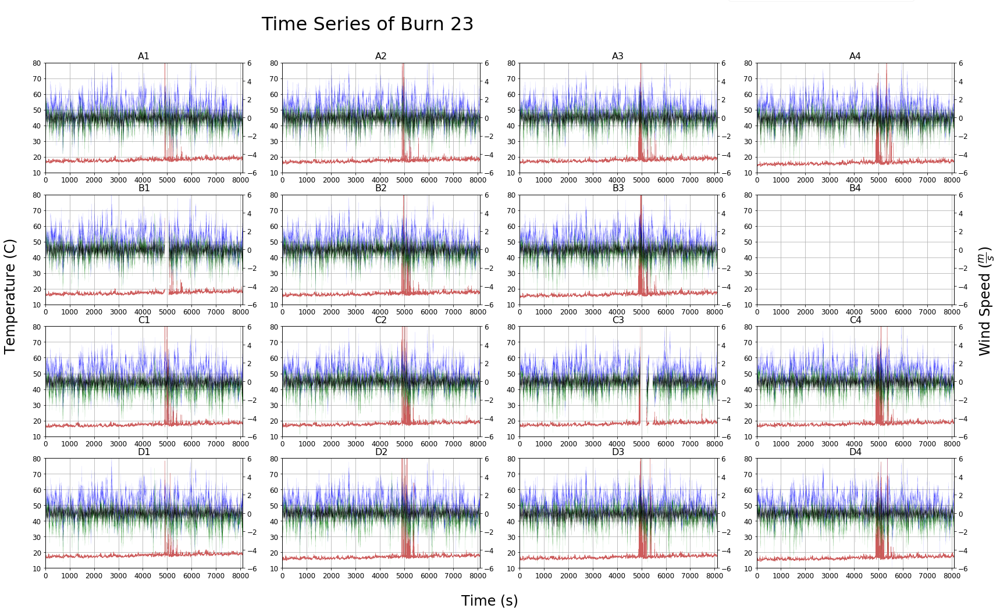

In [66]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-23/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-23/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-23/sonics/" #79 location

plotting(path,str(23),10)

[17.96, 17.38, 17.94, 16.04, 17.28, 16.71, 9.41, nan, 17.32, 17.93, 17.89, 17.76, 18.11, 17.21, 17.05, 16.65]


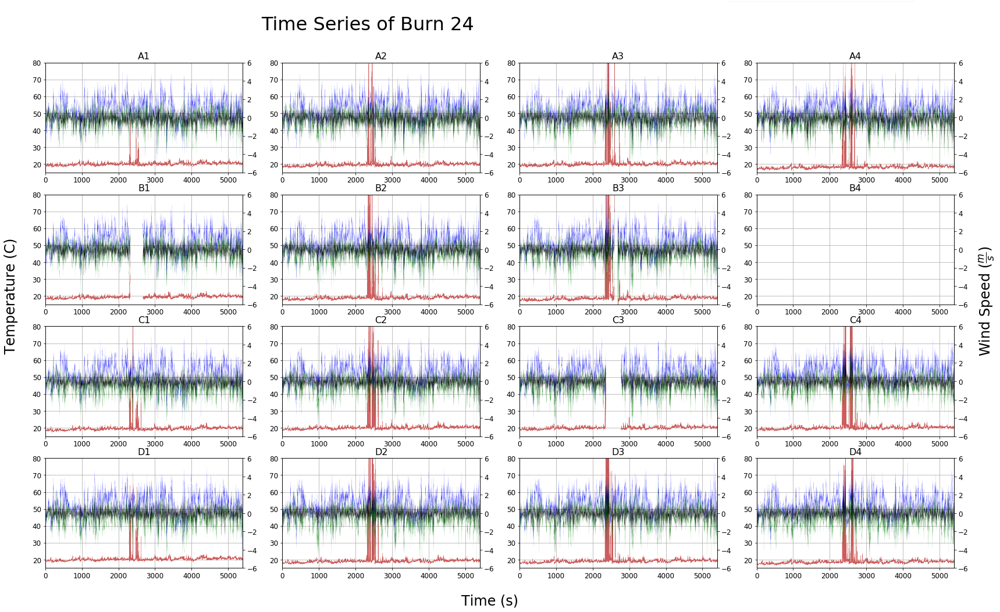

In [67]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-24/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-24/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-24/sonics/" #79 location

plotting(path,str(24),15)

[19.37, 18.65, 19.29, 17.59, 18.4, 17.71, 10.13, nan, 18.49, 19.16, 19.18, 19.08, 19.7, 18.52, 18.63, 17.96]


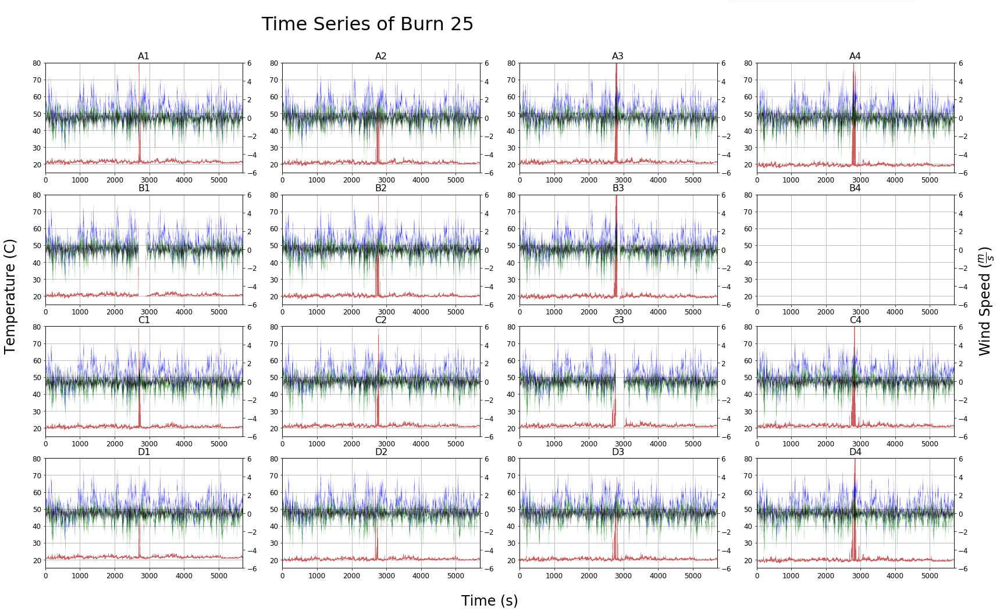

In [68]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-25/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-25/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-25/sonics/" #79 location

plotting(path,str(25),15)

[20.56, 19.95, 20.46, 18.61, 19.83, 18.32, 19.09, nan, 19.8, 20.57, 20.6, 20.14, 20.86, 19.75, 19.73, 19.17]


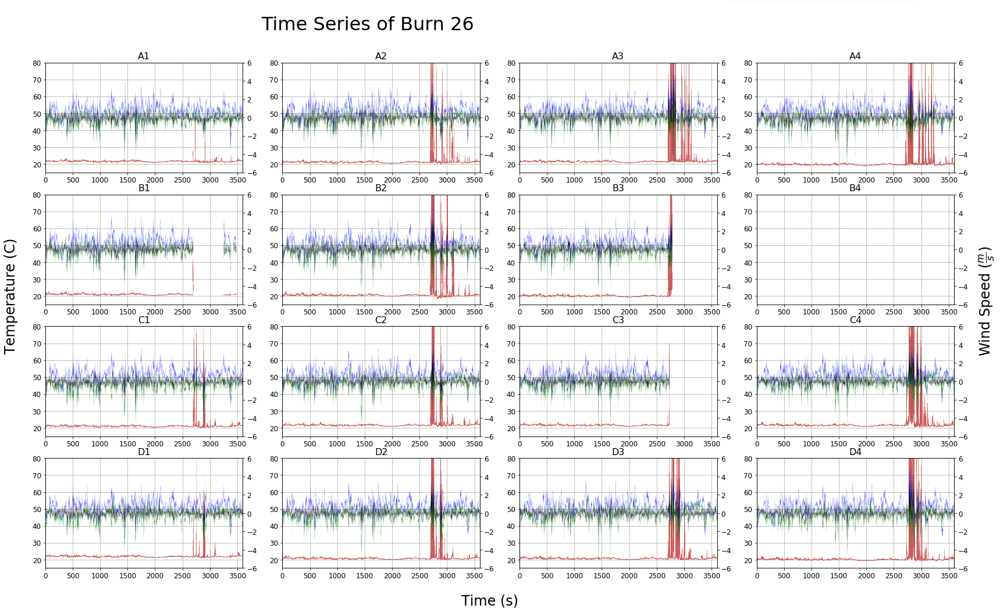

In [69]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-26/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-26/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-26/sonics/" #79 location

plotting(path,str(26),15)

[17.55, 17.1, 17.59, 15.84, 16.72, 16.35, nan, nan, 17.13, 17.81, nan, 17.21, 17.98, 16.77, 16.77, 16.09]


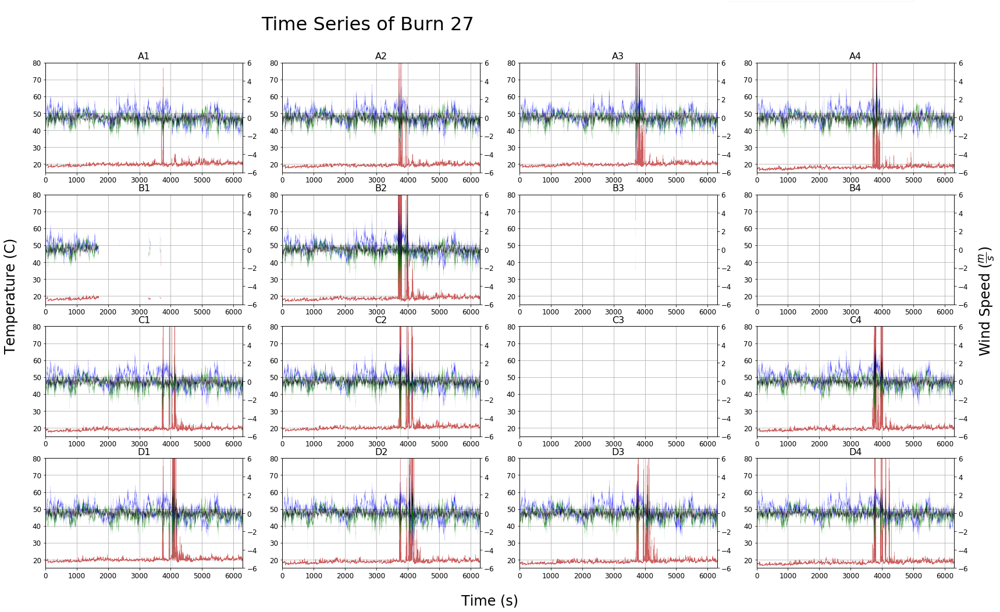

In [70]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-27/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-27/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-27/sonics/" #79 location

plotting(path,str(27),15)

[18.97, 18.58, 19.07, 17.25, nan, 17.82, nan, nan, 18.74, 19.42, nan, 18.7, 19.27, 18.17, 18.1, 17.5]


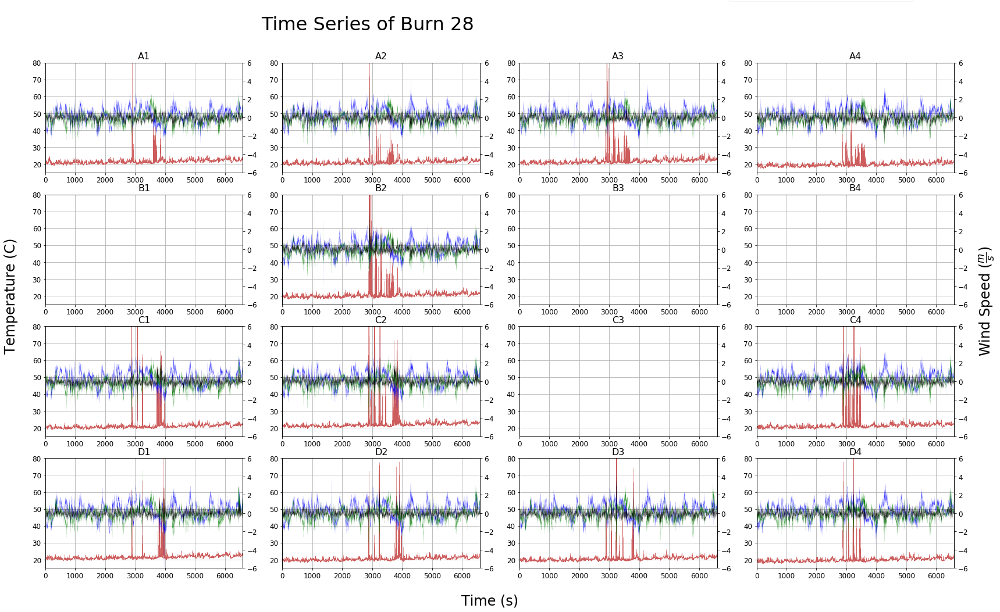

In [71]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-28/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-28/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-28/sonics/" #79 location

plotting(path,str(28),15)

[20.79, 20.36, 20.77, 18.91, nan, 19.53, nan, nan, 20.38, 21.39, nan, 20.51, 21.01, 20.04, 20.01, 19.32]


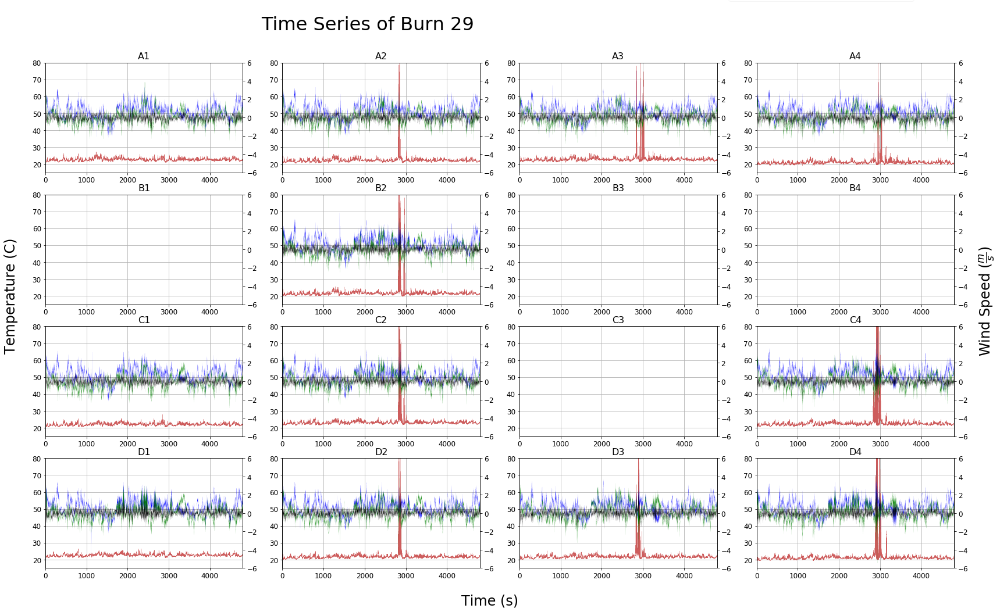

In [72]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-29/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-29/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-29/sonics/" #79 location

plotting(path,str(29),15)

[21.37, 20.89, 21.44, 19.66, nan, 20.31, nan, nan, 20.72, 21.76, nan, 21.15, 21.35, 20.45, 20.53, 19.83]


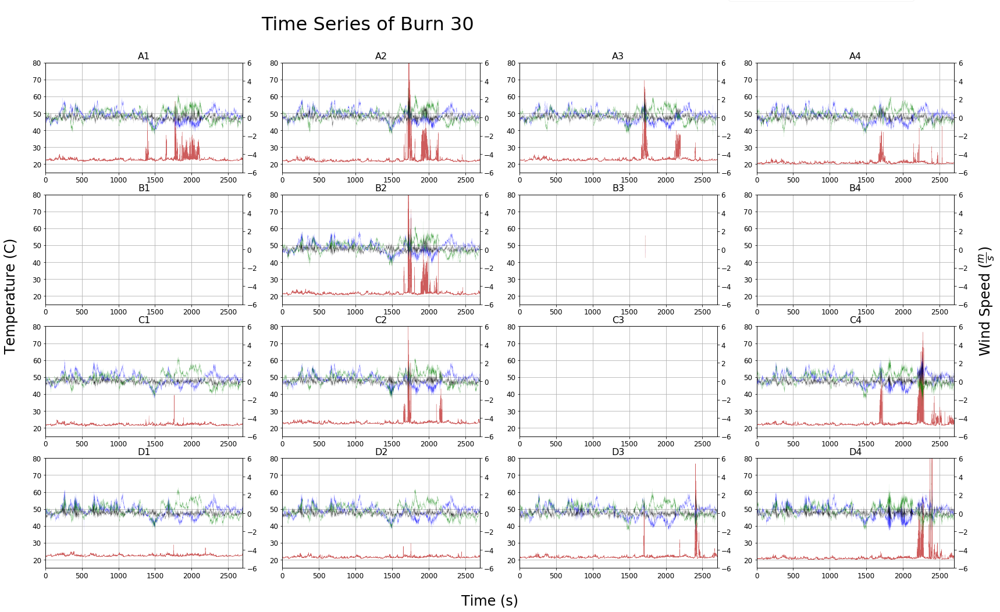

In [73]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-30/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-30/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-30/sonics/" #79 location

plotting(path,str(30),15)

[25.52, 24.89, 25.56, 23.53, 24.89, 24.25, nan, nan, 24.99, 26.11, 25.2, 25.3, 25.49, 24.42, 24.37, 23.96]


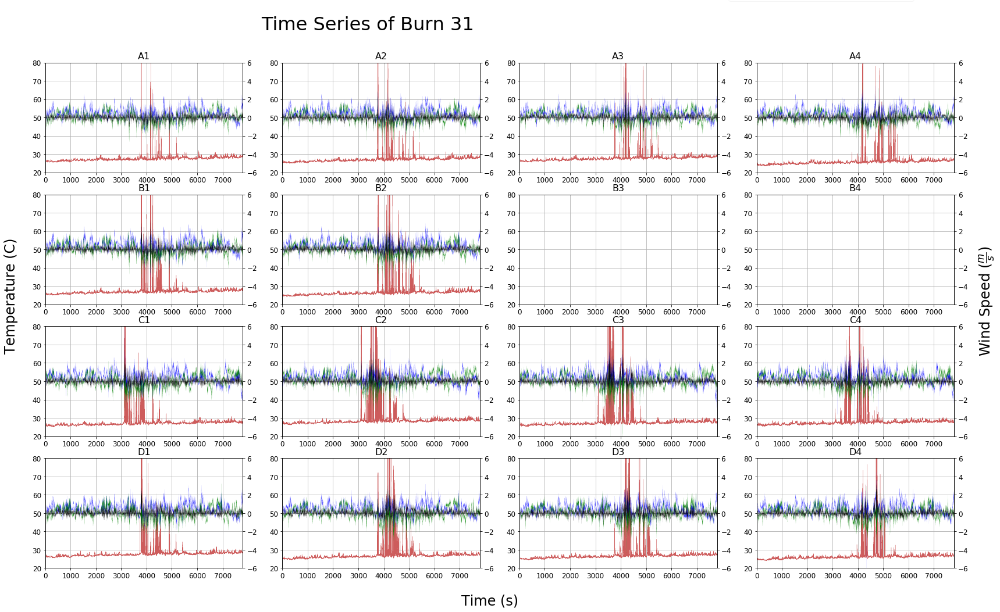

In [74]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-31/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-31/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-31/sonics/" #79 location

plotting(path,str(31),20)

[24.86, 24.3, 24.97, 23.01, 24.19, 23.68, nan, nan, 24.3, 25.3, 24.36, 24.56, 25.02, 23.94, 23.88, 23.31]


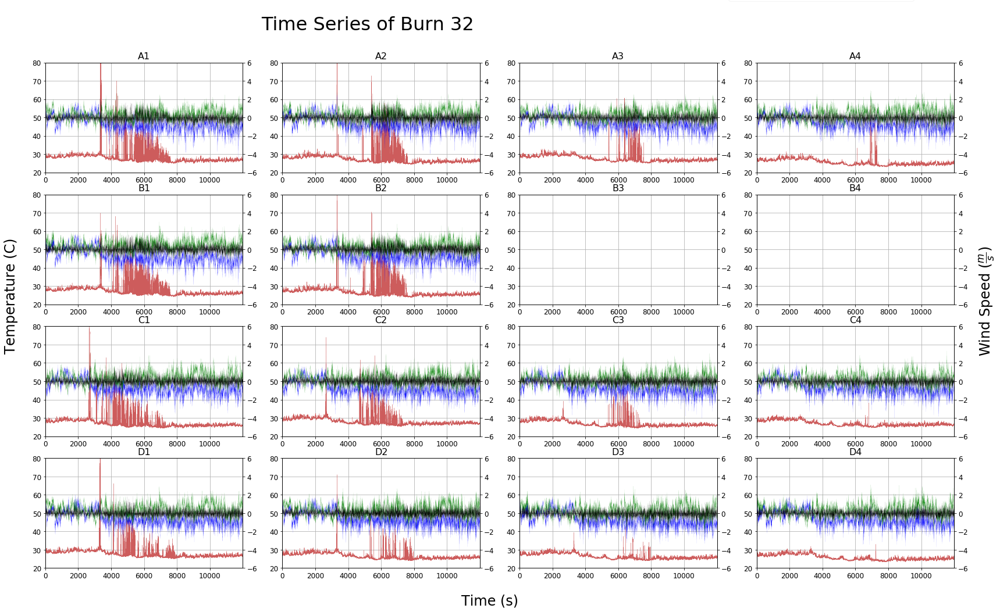

In [75]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-32/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-32/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-32/sonics/" #79 location

plotting(path,str(32),20)

[24.12, 23.83, 24.55, 22.67, 23.52, 23.02, nan, nan, 23.4, 24.55, 23.58, 23.72, 24.79, 23.72, 23.64, 22.96]


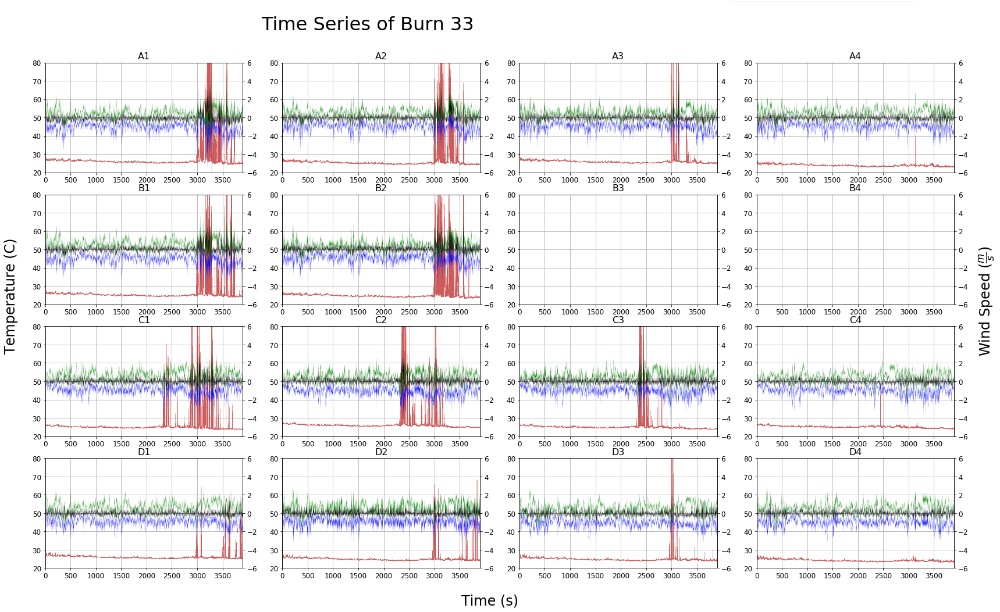

In [76]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-33/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-33/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-33/sonics/" #79 location

plotting(path,str(33),20)

[22.88, 22.19, 22.77, 20.82, 22.11, 21.51, nan, nan, 22.23, 23.08, 22.21, 22.38, 22.79, 21.78, 21.64, 21.29]


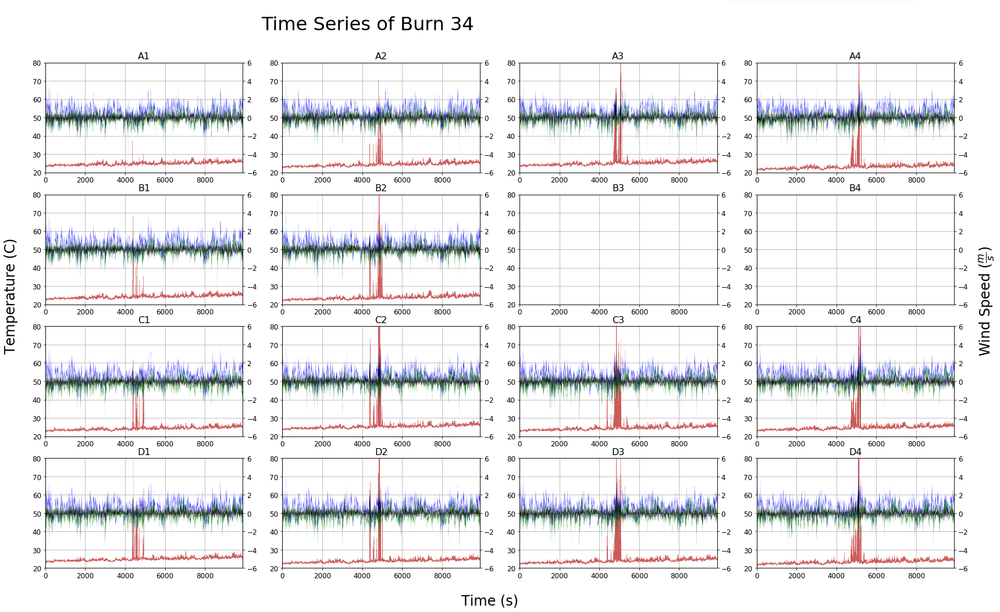

In [77]:
#path= "/home/JoeySeitz/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-34/sonics/"  #134 location
#path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns_May_2018/JS_Cleaned_Data/Burn-34/sonics/" #w10 location
path = "/home/joey/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Burn-34/sonics/" #79 location

plotting(path,str(34),20)